# Generate Patch

## Read a WSI image via openslide

patch 단위로 Image Processing하는 건 현석님이 하시니까 WSI를 patch로 gen하는 code를 빨리 만들어놓는 거

In [22]:
import os

# working_dir = os.getcwd() 
data_dir = '/home/yshwang/data/WSI_patch_generation'
# data_dir = "/mnt/nfs0/jycho/SLIDE_DATA/록원재단_AT2/c-MET Slide"
output_dir = '/home/yshwang/algorithm/c-MET/patch_gen/output'

os.listdir(data_dir)

['S-LC0001-MET.svs', 'annotation', '록원재단_GT450_total file.csv']

In [2]:
os.getcwd()

'/home/yshwang/algorithm/c-MET/patch_gen'

In [3]:
wsl_list = [i for i in os.listdir(data_dir) if 'svs' in i]
wsl_list

['S-LC0001-MET.svs']

In [4]:
import openslide 

slide_name = wsl_list[0]
slide_path = data_dir + '/' + slide_name
slide = openslide.OpenSlide(slide_path)

openslide.OpenSlide

https://openslide.org/api/python/

`dimensions:
A (width, height) tuple for level 0 of the slide.`

In [5]:
slide

OpenSlide('/home/yshwang/data/WSI_patch_generation/S-LC0001-MET.svs')

In [6]:
width, height = slide.dimensions
print(f'{slide_name}(WSI)| width: {width}, height: {height}')

S-LC0001-MET.svs(WSI)| width: 117528, height: 56027


## Make tissue mask

`level_count:
The number of levels in the slide. Levels are numbered from 0 (highest resolution) to level_count - 1 (lowest resolution).`

svs 파일은 여러 scale의 이미지를 가지고 있음 multi-scale format

In [7]:
slide.level_count

4

In [8]:
if slide.level_count < 4:
    level_index = slide.level_count - 1
else:
    level_index = 3

level_index

3

In [9]:
slide.level_dimensions[0], slide.level_dimensions[1], slide.level_dimensions[2]

((117528, 56027), (29382, 14006), (7345, 3501))

tissue mask는 4번째 level에서 추출하는 것이 기준

In [10]:
slide.level_dimensions[level_index]

(3672, 1750)

In [11]:
117528//29382, 117528//7345, 117528//3672

(4, 16, 32)

`get_thumbnail(size):
Return an Image containing an RGB thumbnail of the slide. Parameters
size (tuple) – the maximum size of the thumbnail as a (width, height) tuple`

In [12]:
117528//(1024*2), 56027//(1024*2), (117528//(1024*2))*(56027//(1024*2))

(57, 27, 1539)

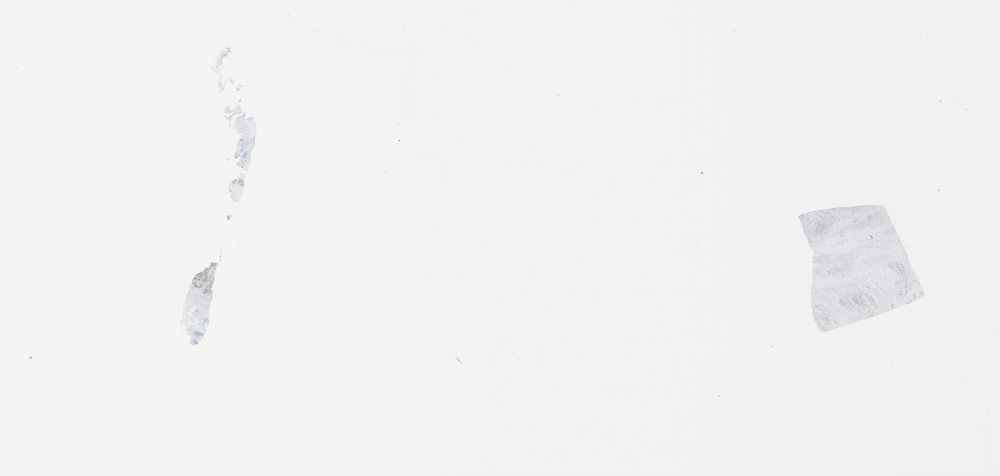

In [13]:
slide_thumbnail = slide.get_thumbnail(slide.level_dimensions[level_index])
slide_thumbnail

In [14]:
type(slide_thumbnail)

PIL.Image.Image

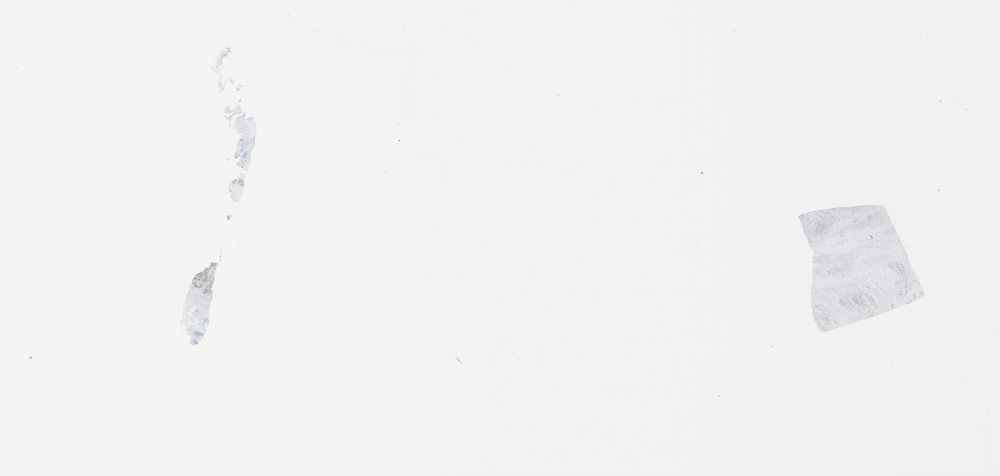

In [15]:
slide_thumbnail = slide_thumbnail.convert('RGB')
slide_thumbnail

In [23]:
slide_thumbnail.save(output_dir +'/'+ slide_name[:-4] + '_0_original_image.jpg')

`
level_downsamples:
A list of downsample factors for each level of the slide. level_downsamples[k] is the downsample factor of level k.
`

In [24]:
slide_thumbnail.size

(3672, 1750)

In [25]:
slide.level_downsamples[level_index]

32.0109822595705

In [26]:
mask_slide_ratio = round(slide.level_downsamples[level_index])
mask_slide_ratio

32

In [27]:
import cv2
import numpy as np

otsu_image = cv2.cvtColor(np.array(slide_thumbnail), cv2.COLOR_BGR2HSV)

opencv, numpy 기준은 (height, width)

In [28]:
type(otsu_image), otsu_image.dtype, otsu_image.shape, otsu_image.max(), otsu_image.min()

(numpy.ndarray, dtype('uint8'), (1750, 3672, 3), 251, 0)

이게 이해가 안 가네 

```python
otsu_image_2 = 1 - otsu_image[:,:,2]
```

In [29]:
otsu_image[:,:,2]

array([[244, 244, 244, ..., 241, 241, 241],
       [244, 244, 244, ..., 241, 241, 241],
       [244, 244, 244, ..., 241, 241, 241],
       ...,
       [244, 244, 244, ..., 240, 240, 240],
       [244, 244, 244, ..., 240, 240, 241],
       [244, 244, 244, ..., 240, 240, 240]], dtype=uint8)

In [30]:
1 - otsu_image[:,:,2]

array([[13, 13, 13, ..., 16, 16, 16],
       [13, 13, 13, ..., 16, 16, 16],
       [13, 13, 13, ..., 16, 16, 16],
       ...,
       [13, 13, 13, ..., 17, 17, 17],
       [13, 13, 13, ..., 17, 17, 16],
       [13, 13, 13, ..., 17, 17, 17]], dtype=uint8)

In [31]:
otsu_image_1 = otsu_image[:,:,1] # S 채널 Saturation 
otsu_image_2 = 1 - otsu_image[:,:,2] # V 채널 Brightness Inversion

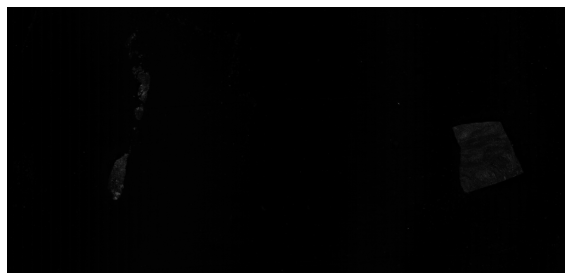

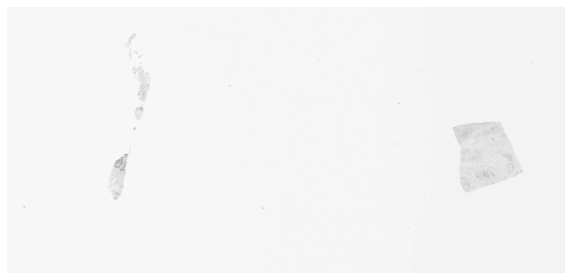

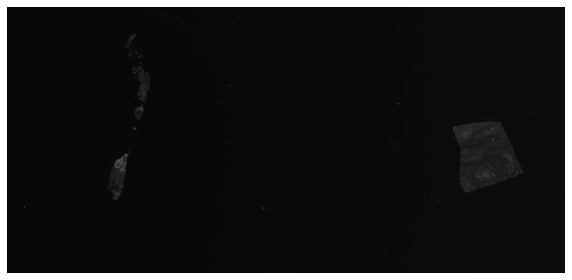

In [32]:
import matplotlib.pyplot as plt

plt.figure(figsize = (10, 10))
plt.imshow(otsu_image_1, cmap = 'gray')
plt.axis('off')
plt.show()

plt.figure(figsize = (10, 10))
plt.imshow(otsu_image[:,:,2], cmap = 'gray')
plt.axis('off')
plt.show()

plt.figure(figsize = (10, 10))
plt.imshow(otsu_image_2, cmap = 'gray')
plt.axis('off')
plt.show()

# cv2.imwrite(output_dir +'/'+ slide_name[:-4] + '_1_tissue_mask_1)hsv_seperation_s_channel.jpg', otsu_image_1)
# cv2.imwrite(output_dir +'/'+ slide_name[:-4] + '_1_tissue_mask_1)hsv_seperation_v_channel_inv.jpg', otsu_image_2)

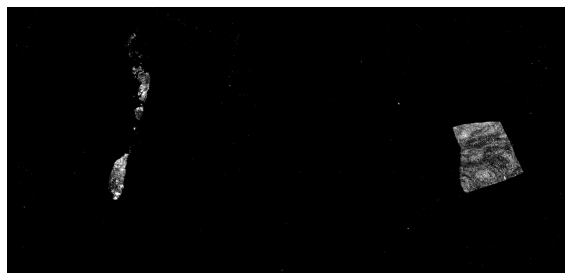

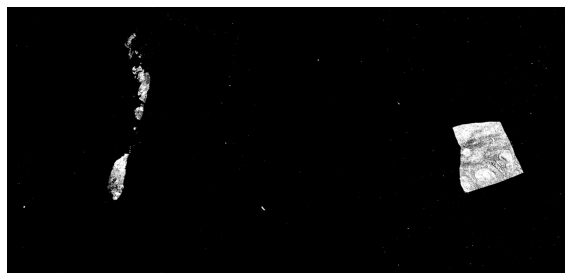

In [33]:
otsu_image_1 = cv2.threshold(otsu_image_1, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]
otsu_image_2 = cv2.threshold(otsu_image_2, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]

plt.figure(figsize = (10, 10))
plt.imshow(otsu_image_1, cmap = 'gray')
plt.axis('off')
plt.show()

plt.figure(figsize = (10, 10))
plt.imshow(otsu_image_2, cmap = 'gray')
plt.axis('off')
plt.show()

# cv2.imwrite(output_dir +'/'+ slide_name[:-4] + '_1_tissue_mask_2)otsu_thresholding_s.jpg', otsu_image_1)
# cv2.imwrite(output_dir +'/'+ slide_name[:-4] + '_1_tissue_mask_2)otsu_thresholding_v_inv.jpg', otsu_image_2)

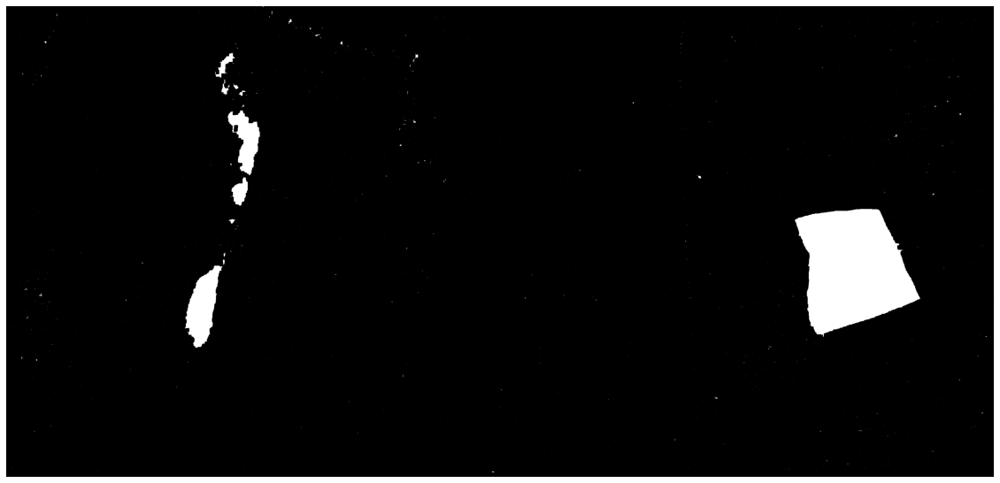

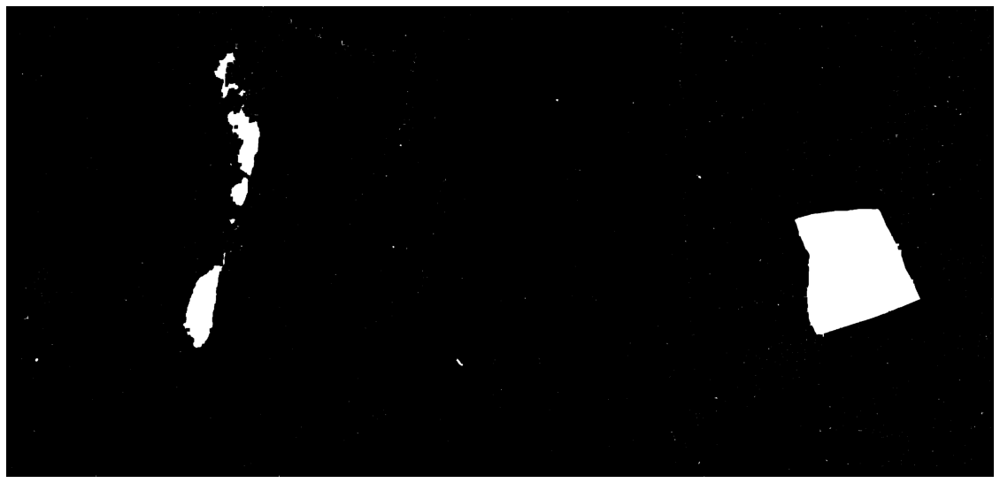

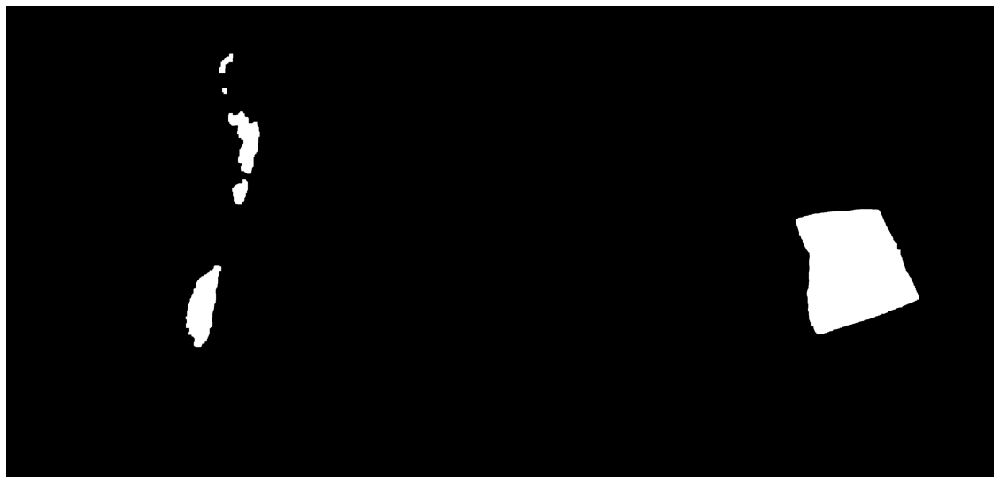

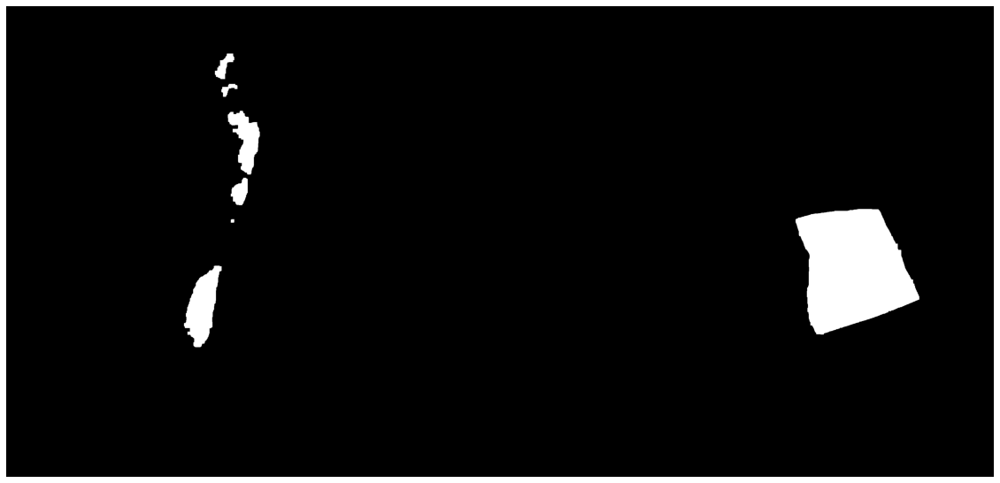

In [34]:
kernel = np.ones((11, 11), dtype = np.uint8)

otsu_image_1 = cv2.morphologyEx(otsu_image_1, cv2.MORPH_CLOSE, kernel)
otsu_image_2 = cv2.morphologyEx(otsu_image_2, cv2.MORPH_CLOSE, kernel)

plt.figure(figsize = (20, 20))
plt.imshow(otsu_image_1, cmap = 'gray')
plt.axis('off')
plt.show()

plt.figure(figsize = (20, 20))
plt.imshow(otsu_image_2, cmap = 'gray')
plt.axis('off')
plt.show()

# cv2.imwrite(output_dir +'/'+ slide_name[:-4] + '_1_tissue_mask_3)morphologyEx_closing_s.jpg', otsu_image_1)
# cv2.imwrite(output_dir +'/'+ slide_name[:-4] + '_1_tissue_mask_3)morphologyEx_closing_v_inv.jpg', otsu_image_2)

otsu_image_1 = cv2.morphologyEx(otsu_image_1, cv2.MORPH_OPEN, kernel)
otsu_image_2 = cv2.morphologyEx(otsu_image_2, cv2.MORPH_OPEN, kernel)

plt.figure(figsize = (20, 20))
plt.imshow(otsu_image_1, cmap = 'gray')
plt.axis('off')
plt.show()

plt.figure(figsize = (20, 20))
plt.imshow(otsu_image_2, cmap = 'gray')
plt.axis('off')
plt.show()
# 
# cv2.imwrite(output_dir +'/'+ slide_name[:-4] + '_1_tissue_mask_4)morphologyEx_opening_s.jpg', otsu_image_1)
# cv2.imwrite(output_dir +'/'+ slide_name[:-4] + '_1_tissue_mask_4)morphologyEx_opening_v_inv.jpg', otsu_image_2)

In [35]:
otsu_image.shape

(1750, 3672, 3)

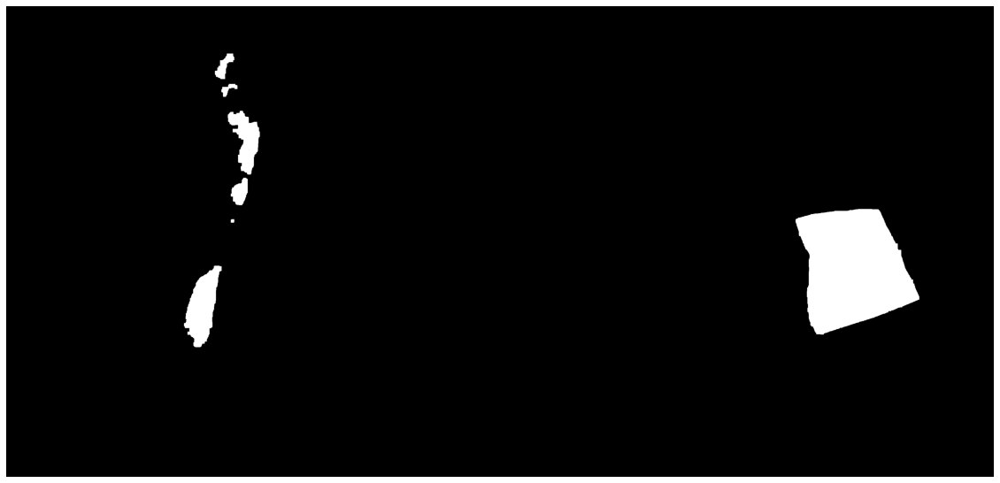

In [36]:
otsu_image = np.logical_or(otsu_image_1, otsu_image_2).astype(float)*255

plt.figure(figsize = (20, 20))
plt.imshow(otsu_image, cmap = 'gray')
plt.axis('off')
plt.show()

# cv2.imwrite(output_dir +'/'+ slide_name[:-4] + '_1_tissue_mask_5)aggregation_logical_or.jpg', otsu_image.astype('uint8'))

In [37]:
otsu_image.dtype

dtype('float64')

In [38]:
tissue_mask = otsu_image

mask_slide_ratio

32

In [39]:
print(f'tissue mask | width: {otsu_image.shape[1]}, height: {otsu_image.shape[0]}')

tissue mask | width: 3672, height: 1750


## Make patch

In [42]:
save_dir = os.path.join(output_dir, 'patch', slide_name[:-4])

try: os.makedirs(save_dir)
except: print("Already exist")

try:
    os.mkdir(os.path.join(save_dir, 'x200'))
    os.mkdir(os.path.join(save_dir, 'x50'))
except:
    print("Already exist")

배율 400으로 가정 (정확히 알아볼 필요가 있음)

In [43]:
width, height

(117528, 56027)

In [44]:
slide_mag = 400

patch_size = 1024

sliding_window = 1
total_point = []

for i in range(sliding_window * width//(patch_size*(slide_mag//200))):
    for j in range(sliding_window * height//(patch_size*(slide_mag//200))):
        total_point.append((i, j))
        
total_point[:10], total_point[-10:]

([(0, 0),
  (0, 1),
  (0, 2),
  (0, 3),
  (0, 4),
  (0, 5),
  (0, 6),
  (0, 7),
  (0, 8),
  (0, 9)],
 [(56, 17),
  (56, 18),
  (56, 19),
  (56, 20),
  (56, 21),
  (56, 22),
  (56, 23),
  (56, 24),
  (56, 25),
  (56, 26)])

In [45]:
from random import shuffle
shuffle?

Signature: shuffle(x, random=None)
Docstring:
Shuffle list x in place, and return None.

Optional argument random is a 0-argument function returning a
random float in [0.0, 1.0); if it is the default None, the
standard random.random will be used.
File:      ~/anaconda3/envs/c-MET/lib/python3.8/random.py
Type:      method


Multiprocessing

In [ ]:
os.cpu_count()

In [46]:
# shuffle(total_point)
num_total_patch = len(total_point)
n_process = 12
queue_size = 15 * n_process

In [47]:
total_point[:5], total_point[-6:-1] 

([(0, 0), (0, 1), (0, 2), (0, 3), (0, 4)],
 [(56, 21), (56, 22), (56, 23), (56, 24), (56, 25)])

In [48]:
from multiprocessing import Manager

Manager?

Signature: Manager()
Docstring:
Returns a manager associated with a running server process

The managers methods such as `Lock()`, `Condition()` and `Queue()`
can be used to create shared objects.
File:      ~/anaconda3/envs/c-MET/lib/python3.8/multiprocessing/context.py
Type:      method


In [49]:
queue = Manager().Queue(queue_size)
queue2 = Manager().Queue(num_total_patch)

In [50]:
queue.empty()

True

In [51]:
from multiprocessing import Pool

Pool?

Signature: Pool(processes=None, initializer=None, initargs=(), maxtasksperchild=None)
Docstring: Returns a process pool object
File:      ~/anaconda3/envs/c-MET/lib/python3.8/multiprocessing/context.py
Type:      method


In [52]:
pool = Pool(n_process)

In [53]:
num_total_patch

1539

In [54]:
split_points = []
for ii in range(n_process):
    split_points.append(total_point[ii:n_process])

In [55]:
split_points

[[(0, 0),
  (0, 1),
  (0, 2),
  (0, 3),
  (0, 4),
  (0, 5),
  (0, 6),
  (0, 7),
  (0, 8),
  (0, 9),
  (0, 10),
  (0, 11)],
 [(0, 1),
  (0, 2),
  (0, 3),
  (0, 4),
  (0, 5),
  (0, 6),
  (0, 7),
  (0, 8),
  (0, 9),
  (0, 10),
  (0, 11)],
 [(0, 2),
  (0, 3),
  (0, 4),
  (0, 5),
  (0, 6),
  (0, 7),
  (0, 8),
  (0, 9),
  (0, 10),
  (0, 11)],
 [(0, 3), (0, 4), (0, 5), (0, 6), (0, 7), (0, 8), (0, 9), (0, 10), (0, 11)],
 [(0, 4), (0, 5), (0, 6), (0, 7), (0, 8), (0, 9), (0, 10), (0, 11)],
 [(0, 5), (0, 6), (0, 7), (0, 8), (0, 9), (0, 10), (0, 11)],
 [(0, 6), (0, 7), (0, 8), (0, 9), (0, 10), (0, 11)],
 [(0, 7), (0, 8), (0, 9), (0, 10), (0, 11)],
 [(0, 8), (0, 9), (0, 10), (0, 11)],
 [(0, 9), (0, 10), (0, 11)],
 [(0, 10), (0, 11)],
 [(0, 11)]]

In [56]:
queue, queue2, patch_size, sliding_window, slide_path, tissue_mask, mask_slide_ratio, slide_mag

(<AutoProxy[Queue] object, typeid 'Queue' at 0x7f494c39d400>,
 <AutoProxy[Queue] object, typeid 'Queue' at 0x7f494c53adc0>,
 1024,
 1,
 '/home/yshwang/data/WSI_patch_generation/S-LC0001-MET.svs',
 array([[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]]),
 32,
 400)

In [57]:
def _make_patch(patch):
    patch = np.array(patch)
    patch = patch.astype(np.float32)
    patch = np.expand_dims(patch, axis=0)
    patch = np.ascontiguousarray(patch, dtype=np.float32)
    return patch

def read_regions_semi(params):

    queue, queue2, points, size, window, slide_dir, tissue_mask, mask_slide_ratio, slide_mag = params
    slide = openslide.OpenSlide(slide_dir)
    step_size = size//window
    mpp_ratio = slide_mag//200

    try:
        for idx, (x, y) in enumerate(points):
            try:
                patch_tissue = tissue_mask[y*mpp_ratio*step_size//mask_slide_ratio:(y+window)*mpp_ratio*step_size//mask_slide_ratio, x*mpp_ratio*step_size//mask_slide_ratio:(x+window)*mpp_ratio*step_size//mask_slide_ratio]
                if patch_tissue.sum() < (size*mpp_ratio//mask_slide_ratio)**2 * 255 * 0.5:
                    continue
            except:
                continue
            queue2.put(1)
            if slide_mag == 800:
                img_x200 = slide.read_region((mpp_ratio*x*step_size, mpp_ratio*y*step_size), 1, (size, size))
                img_x50 = slide.read_region((mpp_ratio*x*step_size - mpp_ratio*size*3//2, mpp_ratio*y*step_size - mpp_ratio*size*3//2), 2, (size, size))
            else:
                img_x200 = slide.read_region((mpp_ratio*x*step_size, mpp_ratio*y*step_size), 0, (size*mpp_ratio, size*mpp_ratio)).resize((size, size))
                img_x50 = slide.read_region((x*mpp_ratio*step_size - size*mpp_ratio*3//2, y*mpp_ratio*step_size - size*mpp_ratio*3//2), 1, (size*mpp_ratio, size*mpp_ratio)).resize((size, size))

            patch = img_x200.convert('L').resize((size//4, size//4))
            patch = _make_patch(patch)
            while True:
                if queue.full():
                    time.sleep(0.01)
                else:
                    queue.put((img_x200, img_x50, patch, x*step_size*mpp_ratio, y*step_size*mpp_ratio))
                    break
        return True

    except Exception as e:
        return e

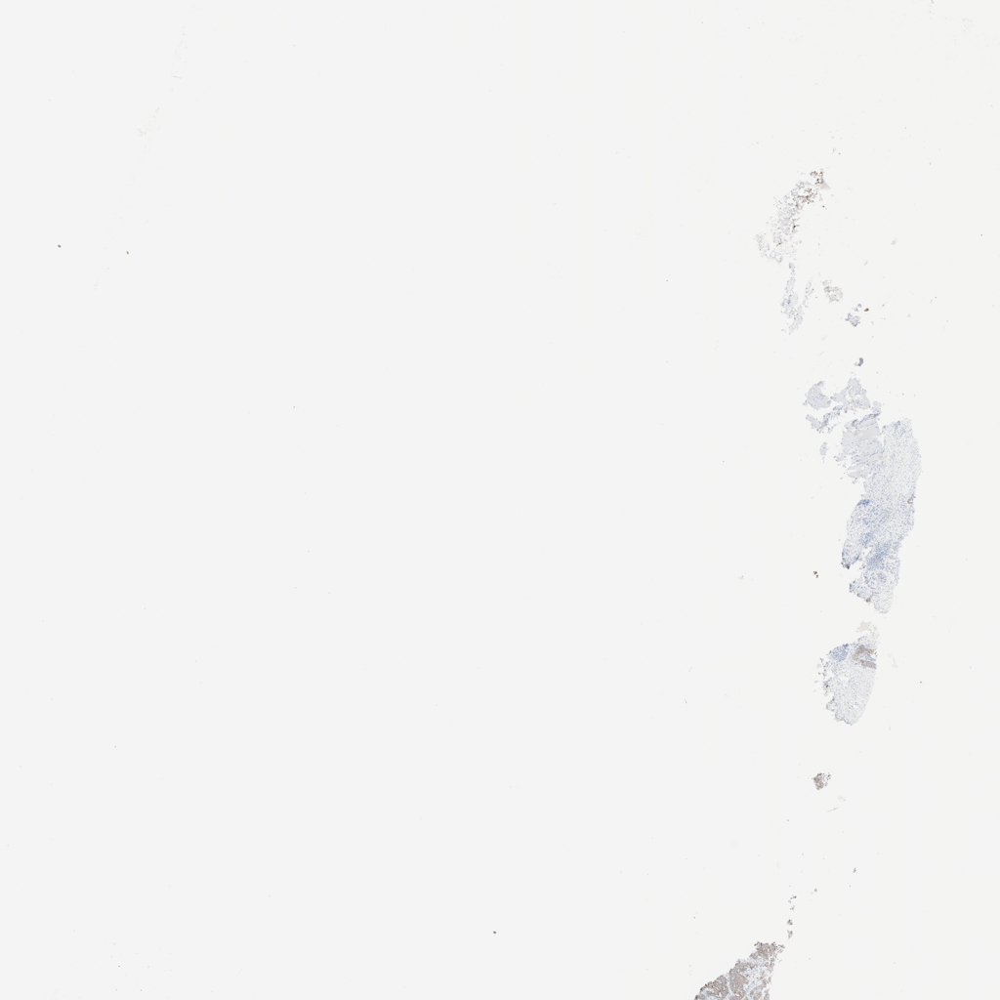

In [58]:
slide.read_region((0, 0), 2, (2048, 2048)).resize((1024, 1024))

In [59]:
try: os.mkdir(os.path.join(output_dir, 'patch', 'x200', 'patch_mask'))
except: print("Already exists")

Already exists


In [60]:
mpp_ratio = slide_mag//200
step_size = patch_size//sliding_window
window = sliding_window
size = patch_size

print(mpp_ratio, mask_slide_ratio, step_size)

patch_tissues, patches = [], []
img_x200_list, img_x50_list = [], []
points, tissue_props = [], []

target_step_size = mpp_ratio*step_size
mask_step_size = target_step_size//mask_slide_ratio

tissue_all_valued = (mask_step_size)**2 * 255
tissue_th = tissue_all_valued*0.1

# count = 0
for idx, (x, y) in enumerate(total_point):
    patch_tissue = tissue_mask[y*mask_step_size:(y+window)*mask_step_size, x*mask_step_size:(x+window)*mask_step_size]
    tissue_prop = patch_tissue.sum()
    
    # cv2.imwrite(os.path.join(output_dir, 'patch', 'x200', 'patch_mask') + '/' + slide_name[:-4] + 
    #             f'_{x*target_step_size}_{y*target_step_size}_prop-{round(tissue_prop/tissue_all_valued, 3)}_tissue_mask.jpg', patch_tissue)
    
    if tissue_prop >= tissue_th:

        img_x200 = slide.read_region((x*target_step_size, y*target_step_size), 0, (target_step_size, target_step_size)).resize((size, size))
        img_x50 = slide.read_region((x*target_step_size - target_step_size*3//2, y*target_step_size - target_step_size*3//2), 1, 
                                    (target_step_size, target_step_size)).resize((size, size))
        # img_x50 = slide.read_region((x*target_step_size//4, y*target_step_size//4), 1, (target_step_size, size*mpp_ratio)).resize((size, size))
        
        patch = img_x200.convert('L').resize((size//4, size//4)) # gray scale로 바꾸고 4배율 낮춰?
        patch = _make_patch(patch)

        patches.append(patch)
        patch_tissues.append(patch_tissue)
        img_x200_list.append(img_x200); img_x50_list.append(img_x50)
        points.append((x*target_step_size, y*target_step_size))
        tissue_props.append(round(tissue_prop/tissue_all_valued, 3))

#         count += 1

#     if count == 5:
#         break

2 32 1024


In [61]:
patch_tissue.shape, patch.shape, img_x200.size, img_x50.size

((64, 64), (1, 256, 256), (1024, 1024), (1024, 1024))

In [62]:
patch_ = img_x200_list[0].convert('L').resize((size//4, size//4))

In [63]:
type(patch_)

PIL.Image.Image

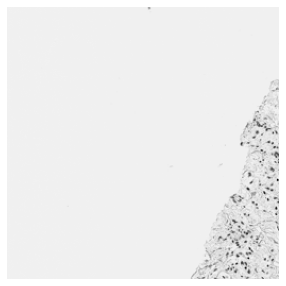

In [64]:
plt.figure(figsize = (5, 5))
plt.imshow(patch_, cmap = 'gray')
plt.axis('off')
plt.show()

uint8


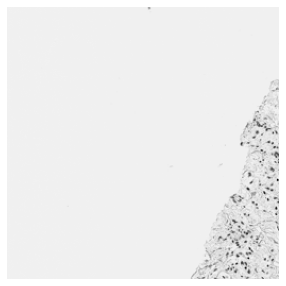

In [65]:
patch_ = np.array(patch_)
print(patch_.dtype)

plt.figure(figsize = (5, 5))
plt.imshow(patch_, cmap = 'gray')
plt.axis('off')
plt.show()

In [66]:
patch_

array([[244, 244, 245, ..., 244, 244, 244],
       [244, 244, 245, ..., 244, 244, 244],
       [244, 244, 244, ..., 244, 244, 244],
       ...,
       [244, 244, 245, ..., 215, 222, 211],
       [244, 244, 244, ..., 225, 233, 234],
       [244, 244, 245, ..., 230, 238, 231]], dtype=uint8)

In [67]:
# patch = patch.astype(np.float32)
patch_ = np.expand_dims(patch_, axis = 0)
patch_ = np.ascontiguousarray(patch_, dtype=np.float32)
patch_

array([[[244., 244., 245., ..., 244., 244., 244.],
        [244., 244., 245., ..., 244., 244., 244.],
        [244., 244., 244., ..., 244., 244., 244.],
        ...,
        [244., 244., 245., ..., 215., 222., 211.],
        [244., 244., 244., ..., 225., 233., 234.],
        [244., 244., 245., ..., 230., 238., 231.]]], dtype=float32)

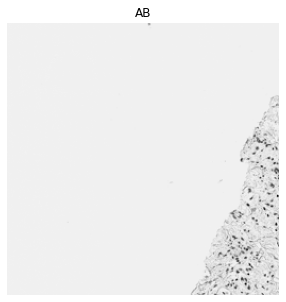

In [68]:
plt.figure(figsize = (5, 5))
plt.title("AB")
plt.imshow(patch_[0], cmap = 'gray')
plt.axis('off')
plt.show()

In [69]:
patches[2]

array([[[244., 245., 245., ..., 219., 230., 227.],
        [244., 245., 244., ..., 231., 217., 221.],
        [244., 245., 244., ..., 246., 245., 242.],
        ...,
        [244., 244., 244., ..., 221., 249., 246.],
        [244., 244., 244., ..., 247., 244., 245.],
        [244., 244., 244., ..., 244., 242., 240.]]], dtype=float32)

In [70]:
len(points)

69

In [71]:
try: os.mkdir(os.path.join(output_dir, 'patch', 'x200', 'plot'))
except: print("Already exists")

Already exists


/tmp/ipykernel_722087/2033727113.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15, 15))


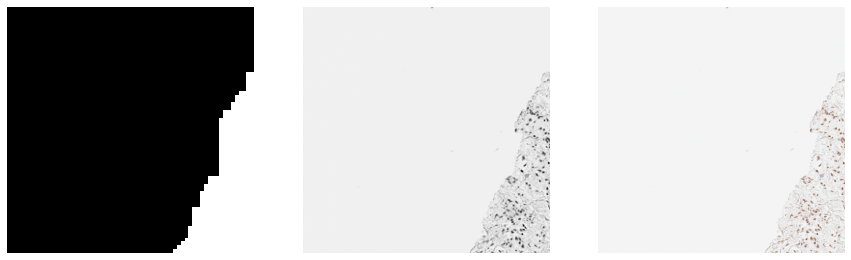

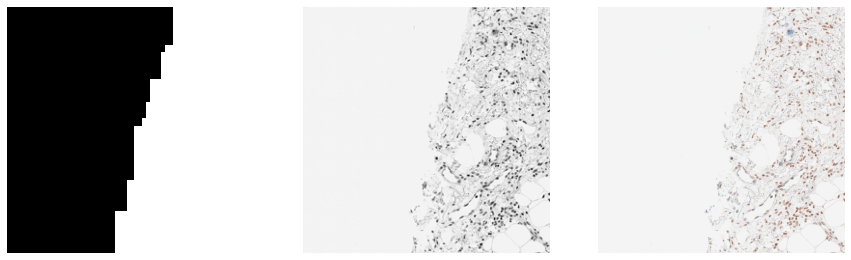

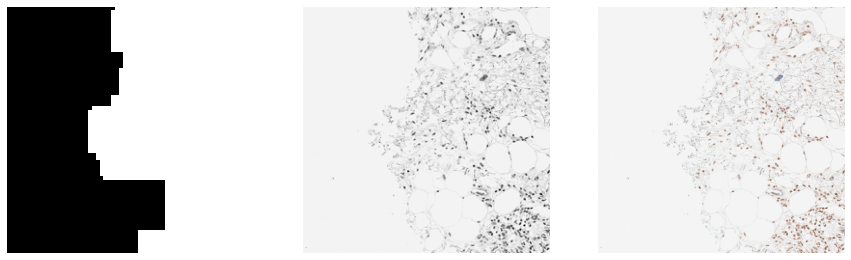

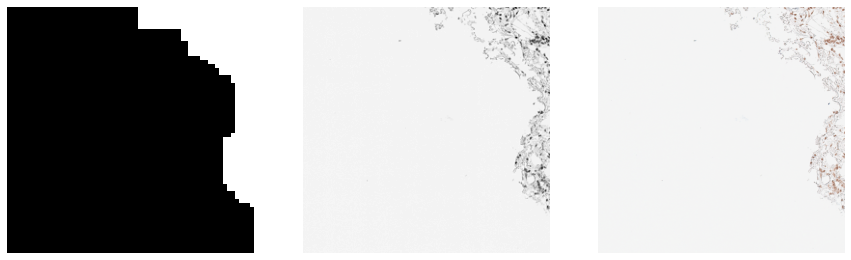

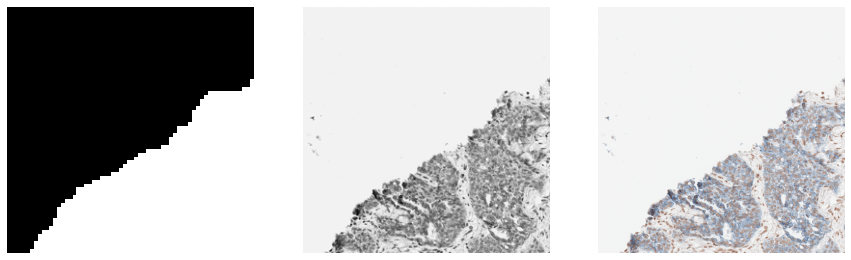

...

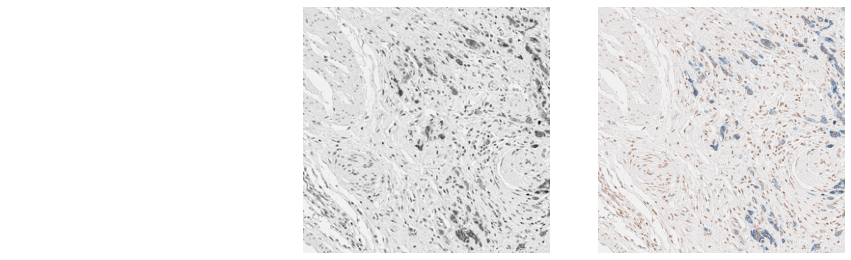

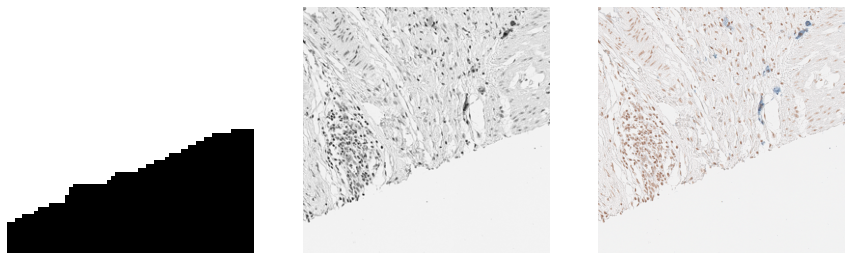

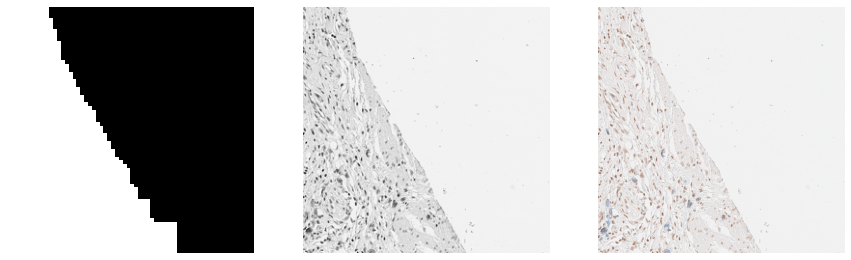

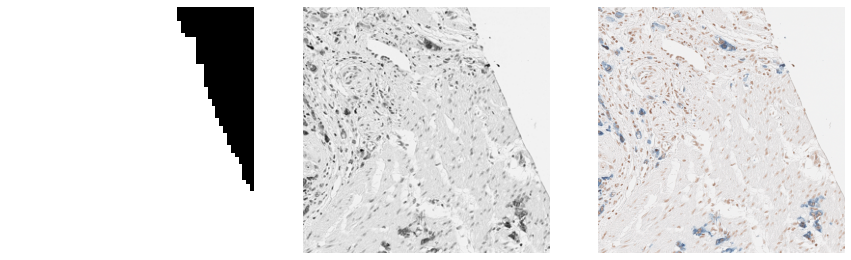

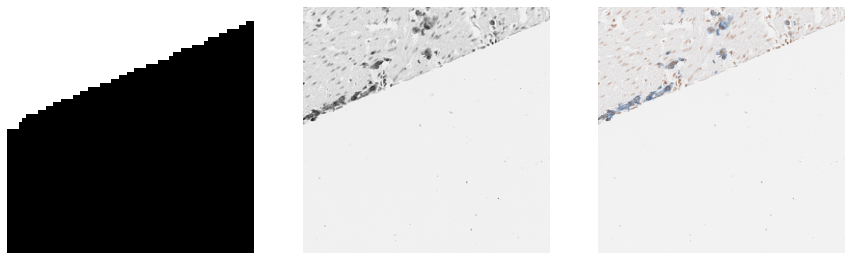

In [72]:
for point, proportion, patch, patch_tissue, patch_img in zip(points, tissue_props, patches, patch_tissues, img_x200_list):
    
    plt.figure(figsize = (15, 15))
    # plt.title(f'coordinate: {point}, proportion: {proportion}', fontsize = 50)
    
    plt.title('aga', fontsize = 50)
    plt.subplot(1, 3, 1)
    plt.imshow(patch_tissue, cmap = 'gray', vmin = 0, vmax = 255)
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(patch[0], cmap = 'gray')
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(cv2.cvtColor(np.array(patch_img.convert('RGB')), cv2.COLOR_BGR2RGB))
    plt.axis('off')
    # plt.show()
    
    # plt.savefig(os.path.join(output_dir, 'patch', 'x200', 'plot') + '/' + slide_name[:-4] + 
    #             f'_plot1_prop-{proportion}_{point[0]}_{point[1]}.png', bbox_inches = 'tight')
    
    # plt.close()
    

## Blurrity check by laplacian filter

In [73]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class laplacian(torch.nn.Module):

    def __init__(self):
        super(laplacian, self).__init__()

        self.conv_filter = torch.tensor([[[[0.0, 1.0, 0.0],
                                           [1.0, -4.0, 1.0],
                                            [0.0, 1.0, 0.0]]]])
        self.conv_filter = torch.FloatTensor(self.conv_filter)
        self.padding = nn.ReflectionPad2d(1)

    def forward(self, x):
        self.conv_filter = self.conv_filter.cuda()
        output = self.padding(x)
        output = F.conv2d(output, self.conv_filter, padding=0)
        return output

def load_model():
    model = laplacian()
    return model

In [74]:
model = load_model()
model = model.cuda()

In [75]:
from collections import deque

batch_size = 16
p_queue = deque(patches)

len(p_queue), p_queue[0].shape

(69, (1, 256, 256))

In [76]:
patch_list, patch_after_lap_list, var_list = [], [], []

while True:
    if len(p_queue) == 0:
        break
    else:
        patch_ = p_queue.popleft()
        patch_list.append(patch_)
        if len(patch_list) == batch_size or len(p_queue) == 0:
            with torch.autograd.no_grad():
                batch = torch.FloatTensor(np.stack(patch_list)).cuda()
                output = model(batch)
            output = output.cpu().data.numpy()
            print(output.shape, output.dtype)
            variance = np.var(output, axis=(1, 2, 3))
            
            patch_after_lap_list.append(output); var_list.append(variance)
            
            patch_list = []

(16, 1, 256, 256) float32
(16, 1, 256, 256) float32
(16, 1, 256, 256) float32
(16, 1, 256, 256) float32
(5, 1, 256, 256) float32


In [77]:
len(patch_after_lap_list), len(var_list)

(5, 5)

In [78]:
for i, (p, v) in enumerate(zip(patch_after_lap_list, var_list)):
    if i == 0:
        patch_after_lap = np.array(p)
        variances = np.array(v)
        
    else:
        patch_after_lap = np.concatenate((patch_after_lap, p))
        variances = np.concatenate((variances, v))

In [79]:
patch_after_lap.shape, variances.shape

((69, 1, 256, 256), (69,))

In [80]:
patch_after_lap = np.squeeze(patch_after_lap, axis = 1)
patch_after_lap.shape

(69, 256, 256)

In [81]:
patch_after_lap.max(), patch_after_lap.min(), patch_after_lap.mean(), patch_after_lap.var(), patch_after_lap.std()

(451.0, -308.0, 0.000101061836, 1634.6893, 40.43129)

In [ ]:
for point, proportion, variance, patch_lap, patch_tissue, patch_img in zip(points, tissue_props, variances, patch_after_lap, patch_tissues, img_x200_list):
    
    plt.figure(figsize = (30, 30))
    plt.subplot(1, 3, 1)
    plt.imshow(patch_tissue.astype('uint8'), cmap = 'gray', vmin = 0, vmax = 255)
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(patch_lap, cmap = 'gray')
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(cv2.cvtColor(np.array(patch_img.convert('RGB')), cv2.COLOR_BGR2RGB))
    plt.axis('off')
    # plt.show('off')
    
    # plt.savefig(os.path.join(output_dir, 'patch', 'x200', 'plot') + '/' + slide_name[:-4] + 
    #             f'_plot2_var-{round(variance):05d}_prop-{proportion}_{point[0]}_{point[1]}.png', bbox_inches = 'tight')
    

In [82]:
type(patch_img)

PIL.Image.Image

In [ ]:
for point, proportion, variance, img in zip(points, tissue_props, variances, img_x200_list):
    
    img.convert('RGB').save(os.path.join(output_dir, 'patch', 'x200') + '/' + slide_name[:-4] + 
                f'_var-{round(variance):05d}_prop-{proportion}_{point[0]}_{point[1]}.jpg')
    

#### Blurrity를 실제로 variance로 추정가능한 지 테스트

In [87]:
test_idx = list(variances).index(max(variances))
test_idx

31

In [88]:
test_patch = img_x200_list[test_idx].convert('L').resize((size//4, size//4)) # gray scale로 바꾸고 4배율 낮춰?
test_patch = _make_patch(test_patch)

from PIL import Image, ImageFilter

g_blurred_2_patch = img_x200_list[test_idx].filter(ImageFilter.GaussianBlur(radius = 2))
g_blurred_2_patch = g_blurred_2_patch.convert('L').resize((size//4, size//4))
g_blurred_2_patch = _make_patch(g_blurred_2_patch)

g_blurred_5_patch = img_x200_list[test_idx].filter(ImageFilter.GaussianBlur(radius = 5))
g_blurred_5_patch = g_blurred_5_patch.convert('L').resize((size//4, size//4))
g_blurred_5_patch = _make_patch(g_blurred_5_patch)

test_items = [test_patch, g_blurred_2_patch, g_blurred_5_patch]

In [90]:
with torch.autograd.no_grad():
    batch = torch.FloatTensor(np.stack(test_items)).cuda()
    output = model(batch)
    output = output.cpu().data.numpy()
    variance = np.var(output, axis=(1, 2, 3))
    
print(variance)

[3725.2769  1042.9338    54.78189]


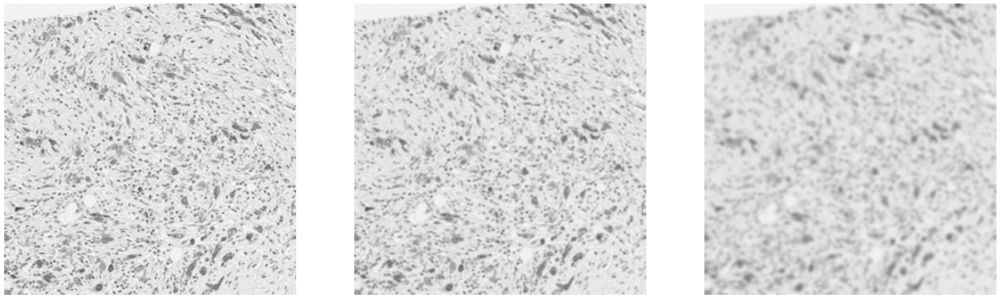

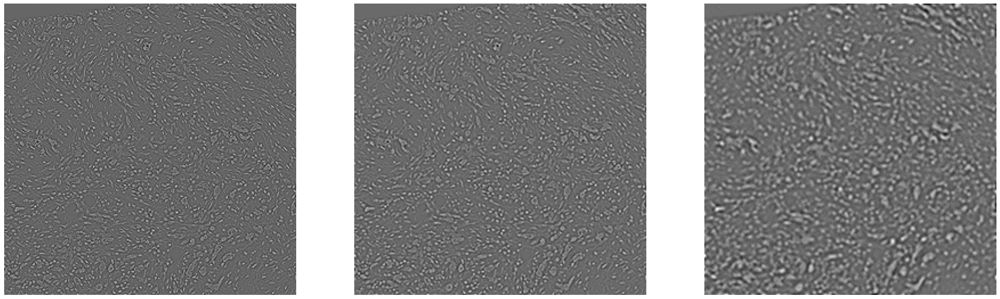

In [91]:
plt.figure(figsize = (30, 30))
plt.subplot(1, 3, 1)
plt.imshow(test_patch[0], cmap = 'gray', vmin = 0, vmax = 255)
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(g_blurred_2_patch[0], cmap = 'gray', vmin = 0, vmax = 255)
plt.axis('off')    

plt.subplot(1, 3, 3)
plt.imshow(g_blurred_5_patch[0], cmap = 'gray', vmin = 0, vmax = 255)
plt.axis('off')    

plt.figure(figsize = (30, 30))
plt.subplot(1, 3, 1)
plt.imshow(output[0][0], cmap = 'gray')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(output[1][0], cmap = 'gray')
plt.axis('off')    

plt.subplot(1, 3, 3)
plt.imshow(output[2][0], cmap = 'gray')
plt.axis('off')    

plt.show()

### Draw patch box on the WSI 

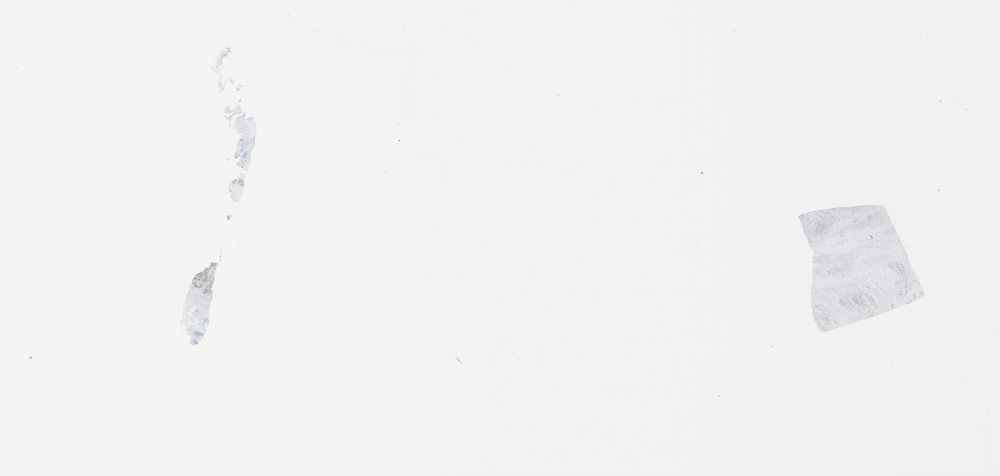

In [85]:
slide_thumbnail = slide.get_thumbnail((tissue_mask.shape[1], tissue_mask.shape[0])) 
slide_thumbnail = slide_thumbnail.convert('RGB')

slide_thumbnail

In [92]:
mask_slide_ratio

32

In [93]:
mask_step_size

64

In [107]:
slide_.shape

(1750, 3672, 3)

In [101]:
slide_ = np.array(slide_thumbnail, dtype=np.uint8)

for (x, y) in points:

    slide_ = cv2.rectangle(slide_, (x//mask_slide_ratio, y//mask_slide_ratio), 
    (x//mask_slide_ratio+mask_step_size, y//mask_slide_ratio+mask_step_size), (0, 255, 0), thickness=2)


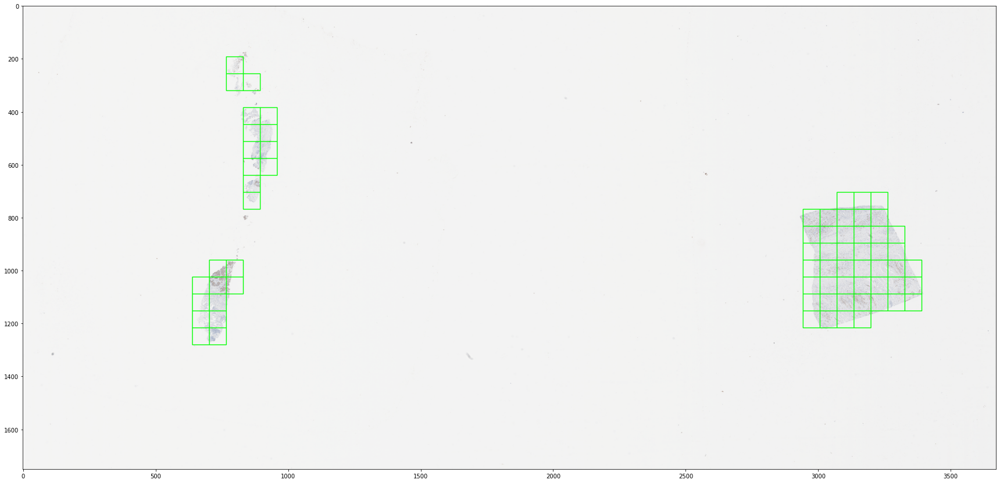

In [106]:
plt.figure(figsize=(30,30))
plt.imshow(slide_)
# plt.axis('on')
plt.show()